**Table of contents**<a id='toc0_'></a>    
- [Imports](#toc1_)    
- [Loading vgg](#toc2_)    
  - [content loss](#toc2_1_)    
  - [style loss](#toc2_2_)    
- [Gradient Descent](#toc3_)    
  - [influence of the style and content weights](#toc3_1_)    
  - [Comparing adam and lbfgs](#toc3_2_)    
  - [visualizing difference between sgd, adam and lbfgs](#toc3_3_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Imports](#toc0_)

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"


In [2]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn as nn
import torch
import torchvision
import einops
import random
import gc
import wandb

from torch import Tensor
from matplotlib import cm
from icecream import ic
from typing import Union, List, Tuple, Literal
from tqdm.auto import tqdm, trange
from IPython.display import display, Markdown
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset, Dataset
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
from skimage.feature import hog
from skimage import exposure


In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu")
print(f"using {device.type}")


using cuda


# <a id='toc2_'></a>[Loading vgg](#toc0_)

In [4]:
vgg_model = torchvision.models.vgg19(weights=torchvision.models.VGG19_Weights.DEFAULT).to(device)


In [5]:
vgg_model


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [6]:
CONV_LAYERS = [idx for idx, layer in enumerate(vgg_model.features) if isinstance(layer, nn.Conv2d)]
CONTENT_LOSS_LAYER = 3
STYLE_LOSS_LAYERS = [i for i in range(5)]


In [7]:
for param in vgg_model.parameters():
    param.requires_grad = False


## <a id='toc2_1_'></a>[content loss](#toc0_)

In [8]:
def content_loss(src_img: Tensor, target_img: Tensor, model: nn.Module, layer: int=CONV_LAYERS[CONTENT_LOSS_LAYER]) -> Tensor:
    """

    Args:
        src_img (Tensor): of shape (1, c, h, w)
        target_img (Tensor): of shape (1, c, h, w)
        model (nn.Module): The model to use to get the feature maps.
        layer (int, optional): Which layer to hook into to get feature representation. 
                                Defaults to CONV_LAYERS[CONTENT_LOSS_LAYER].

    Returns:
        Tensor: The MSE loss between the feature maps of the source and target images.
    """    
    model.to(device)
    model.eval()
    features = []
    
    def content_hook(module, input, output):
        features.append(output)

    hook = model.features[layer].register_forward_hook(content_hook)

    src_img = src_img.to(device)
    target_img = target_img.to(device)
    model(src_img)
    model(target_img)

    hook.remove()

    src_features = features[0]
    target_features = features[1]

    del src_img, target_img, features
    
    return nn.functional.mse_loss(src_features, target_features)


## <a id='toc2_2_'></a>[style loss](#toc0_)

In [9]:
def style_loss(src_img: Tensor, target_img: Tensor, model: nn.Module, layers: list = [CONV_LAYERS[i] for i in STYLE_LOSS_LAYERS]):
    """
    Args:
        src_img (Tensor): of shape (1, c, h, w)
        target_img (Tensor): of shape (1, c, h, w)
        model (nn.Module): The model to use to get the feature maps.
        layers (list, optional): a list of layers over which the style loss is calculated.
                                the loss is the sum over the losses at each of these layers.
                                Defaults to [CONV_LAYERS[i] for i in STYLE_LOSS_LAYERS].

    Returns:
        Tensor || 0: Tensor if the loss is calculated, 0 if no layers were specified
    """    
    model.to(device)
    model.eval()
    src_img = src_img.to(device)
    target_img = target_img.to(device)

    loss = 0
    features = []

    def style_hook(module, input, output):
        features.append(output)

    for layer in layers:
        hook = model.features[layer].register_forward_hook(style_hook)
        model(src_img)
        model(target_img)
        hook.remove()

        src_features = features[-2]
        target_features = features[-1]
        src_f = einops.rearrange(src_features, "1 c h w -> c (h w)").contiguous()
        target_f = einops.rearrange(target_features, "1 c h w -> c (h w)").contiguous()
        # src_f = src_features.squeeze(0).reshape(src_features.shape[1], -1)
        # target_f = target_features.squeeze(0).reshape(target_features.shape[1], -1)
        
        # k = src_f.shape[0]
        k = model.features[layer].kernel_size[0]
        n = src_f.shape[1]
        normalizing_factor = k * n

        src_gram = (src_f @ src_f.T) / (normalizing_factor)
        target_gram = (target_f @ target_f.T) / (normalizing_factor)

        loss += nn.functional.mse_loss(src_gram, target_gram)

        del src_f, target_f, src_gram, target_gram, src_features, target_features
    
    del src_img, target_img, features

    return loss


# <a id='toc3_'></a>[Gradient Descent](#toc0_)

In [10]:
def train(
    content_img: Tensor, 
    style_img: Tensor, 
    model: nn.Module, 
    num_steps: int = 300, 
    content_weight: float = 1e5, 
    style_weight: float = 1e9,
    optimizer: Union[Literal["adam", "lbfgs"], torch.optim.Optimizer] = "lbfgs"
):
    """
    Args:
        content_img (Tensor): The content image tensor of shape (1, C, H, W).
        style_img (Tensor): The style image tensor of shape (1, C, H, W).
        model (nn.Module): The feature extraction model (VGG19).
        num_steps (int, optional): Number of optimization steps. Defaults to 300.
        content_weight (float, optional): Weight for content loss. Defaults to 1e5.
        style_weight (float, optional): Weight for style loss. Defaults to 1e10.

    Returns:
        Tensor: The optimized image.
    """
    # Initialize the generated image as a copy of the content image
    generated_img = content_img.detach().clone().to(device)
    generated_img.requires_grad = True
    
    if optimizer == "adam":
        optimizer = torch.optim.Adam([generated_img], lr=0.1)

        for _ in trange(num_steps):
            optimizer.zero_grad()
            
            content_loss_value = content_loss(generated_img, content_img, model)
            style_loss_value = style_loss(generated_img, style_img, model)
            
            total_loss = content_weight * content_loss_value + style_weight * style_loss_value
            total_loss.backward()

            if generated_img.grad is not None and not generated_img.grad.is_contiguous():
                generated_img.grad = generated_img.grad.contiguous()
            
            optimizer.step()
            with torch.no_grad():
                generated_img.clamp_(0, 1)
    elif optimizer == "lbfgs":
        optimizer = torch.optim.LBFGS([generated_img], lr=0.1, line_search_fn="strong_wolfe")
        
        def closure():
            optimizer.zero_grad()
            
            content_loss_value = content_loss(generated_img, content_img, model)
            style_loss_value = style_loss(generated_img, style_img, model)
            
            total_loss = content_weight * content_loss_value + style_weight * style_loss_value
            total_loss.backward()

            if generated_img.grad is not None and not generated_img.grad.is_contiguous():
                generated_img.grad = generated_img.grad.contiguous()
            
            with torch.no_grad():
                generated_img.clamp_(0, 1)
            
            return total_loss
        
        for _ in trange(num_steps):
            optimizer.step(closure)
            with torch.no_grad():
                generated_img.clamp_(0, 1)
    
    with torch.no_grad():
        generated_img.clamp_(0, 1)
    
    return generated_img


In [21]:
def plot_results(content_img, style_img, generated_img, title=""):
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(content_img)
    axs[0].set_title("Content Image")
    axs[0].axis("off")
    axs[1].imshow(style_img)
    axs[1].set_title("Style Image")
    axs[1].axis("off")
    axs[2].imshow(generated_img)
    axs[2].set_title("Generated Image")
    axs[2].axis("off")
    if title:
        plt.suptitle(title)
    plt.tight_layout()
    plt.show()


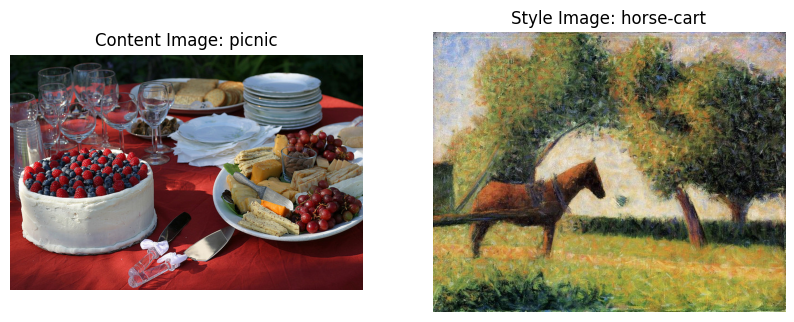

In [11]:
# pick a random content image from the content folder
content_img_path = random.choice(os.listdir("content"))
style_img_path = random.choice(os.listdir("styles"))

content_img = cv2.cvtColor(cv2.imread(f"content/{content_img_path}"), cv2.COLOR_BGR2RGB)
style_img = cv2.cvtColor(cv2.imread(f"styles/{style_img_path}"), cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(content_img)
axs[0].set_title(f"Content Image: {content_img_path.split('.')[0]}")
axs[0].axis("off")
axs[1].imshow(style_img)
axs[1].set_title(f"Style Image: {style_img_path.split('.')[0]}")
axs[1].axis("off")
plt.show()


In [ ]:
content_img = cv2.resize(content_img.astype(np.float32) / 255, (224, 224))
style_img = cv2.resize(style_img.astype(np.float32) / 255, (224, 224))

content_img_tensor = torch.tensor(content_img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)
style_img_tensor = torch.tensor(style_img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)


In [13]:
style_loss(content_img_tensor, style_img_tensor, vgg_model)


tensor(0.0626, device='cuda:0')

In [14]:
content_loss(content_img_tensor, style_img_tensor, vgg_model)


tensor(2.0225, device='cuda:0')

In [15]:
generated_img = train(content_img_tensor, style_img_tensor, vgg_model, num_steps=80, style_weight=1e10, content_weight=1e4)

generated_img = einops.rearrange(generated_img.squeeze(0).contiguous(), "c h w -> h w c").cpu().detach().numpy()



  0%|          | 0/80 [00:00<?, ?it/s]

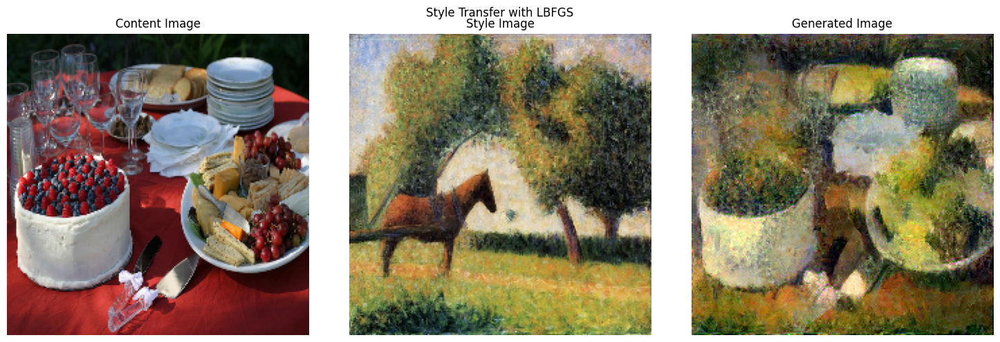

In [22]:
plot_results(content_img, style_img, generated_img, title="Style Transfer with LBFGS")


In [18]:
adam_generated_img = train(content_img_tensor, style_img_tensor, vgg_model, num_steps=80, style_weight=1e10, content_weight=1e4, optimizer="adam")

adam_generated_img = einops.rearrange(adam_generated_img.squeeze(0).contiguous(), "c h w -> h w c").cpu().detach().numpy()



  0%|          | 0/80 [00:00<?, ?it/s]

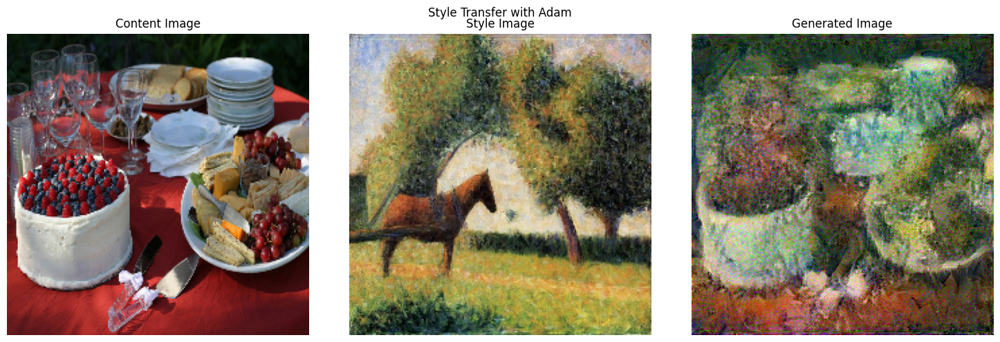

In [23]:
plot_results(content_img, style_img, adam_generated_img, title="Style Transfer with Adam")


## <a id='toc3_1_'></a>[influence of the style and content weights](#toc0_)

In [17]:
def try_different_weights(model, content_img, style_img, n_steps: int=100):
    weights = [[1e12, 1e4], [1e10, 1e4], [1e9, 1e4], [1e7, 1e4], [1e4, 1e4], [1e2, 1e4]]
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(content_img.squeeze(0).permute(1, 2, 0))
    axs[0].set_title("Content Image")
    axs[0].axis("off")
    axs[1].imshow(style_img.squeeze(0).permute(1, 2, 0))
    axs[1].set_title("Style Image")
    axs[1].axis("off")
    plt.tight_layout()
    plt.show()

    fig, axs = plt.subplots(3, 2, figsize=(25, 25))
    axs = axs.flatten() 
    axs_idx = 0

    for i in trange(6):
        style_weight, content_weight = weights[i]
        generated_img = train(content_img, style_img, model, num_steps=n_steps, content_weight=content_weight, style_weight=style_weight)
        generated_img = einops.rearrange(generated_img.squeeze(0).contiguous(), "c h w -> h w c").cpu().detach().numpy()
        axs[axs_idx].imshow(generated_img)
        axs[axs_idx].set_title(f"Content Weight: {content_weight:.4e}, Style Weight: {style_weight:.4e}")
        axs[axs_idx].axis("off")
        axs_idx += 1


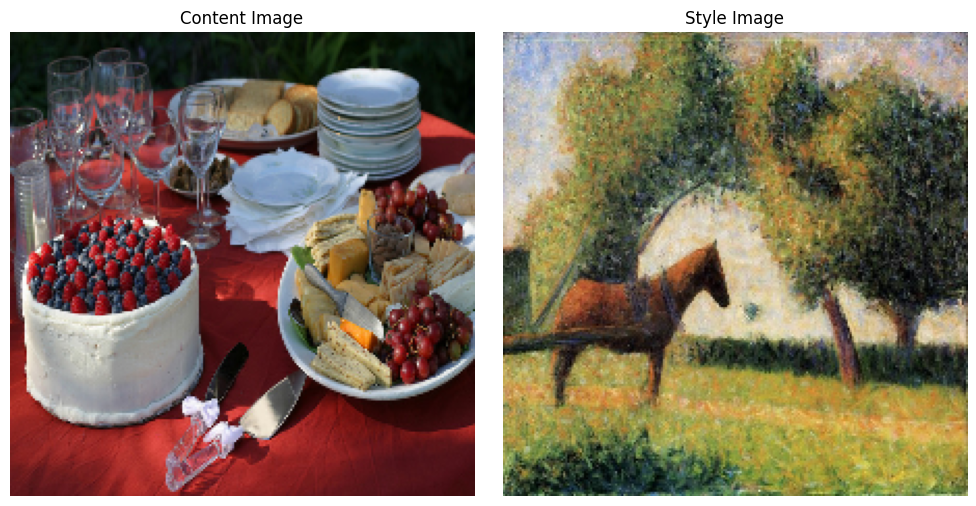

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

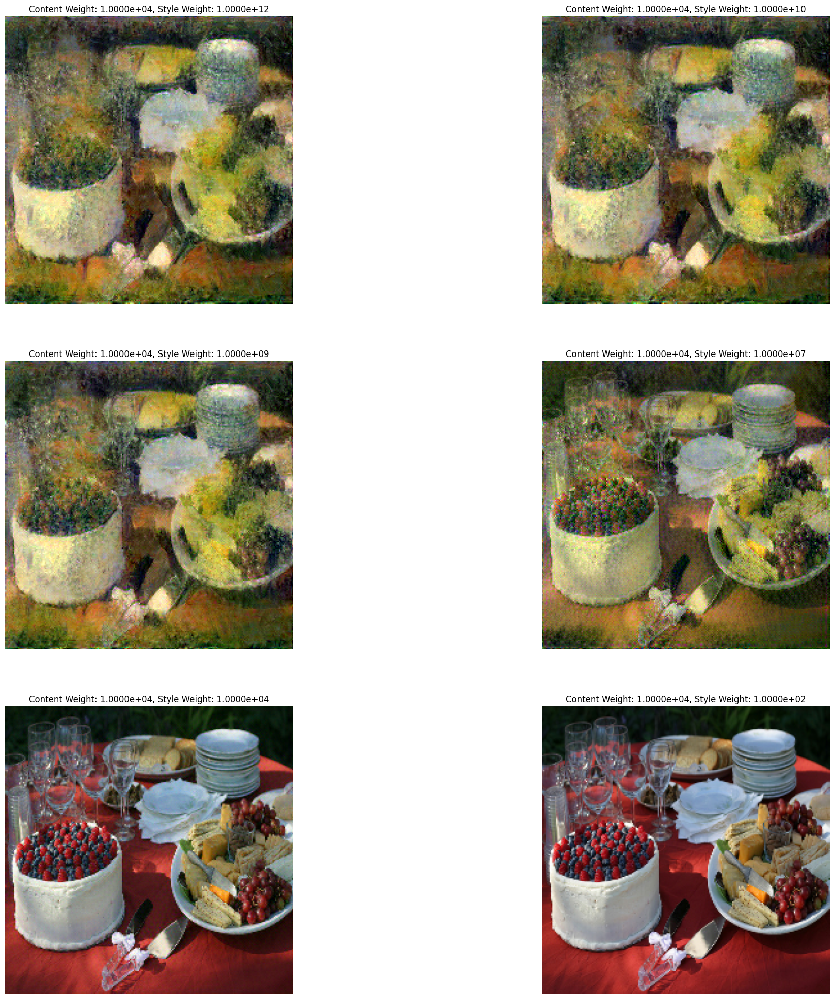

In [24]:
try_different_weights(vgg_model, content_img_tensor, style_img_tensor)


## <a id='toc3_2_'></a>[Comparing adam and lbfgs](#toc0_)

In [26]:
def compare_adam_lbfgs(model, n_steps: int=80, style_weight: float=1e10, content_weight: float=1e4, n_comparisons: int=5):
    fig, axs = plt.subplots(n_comparisons, 4, figsize=(25, 25))

    for i in trange(n_comparisons):
        content_img_path = random.choice(os.listdir("content"))
        style_img_path = random.choice(os.listdir("styles"))

        content_img = cv2.cvtColor(cv2.imread(f"content/{content_img_path}"), cv2.COLOR_BGR2RGB)
        style_img = cv2.cvtColor(cv2.imread(f"styles/{style_img_path}"), cv2.COLOR_BGR2RGB)

        content_img = cv2.resize(content_img.astype(np.float32) / 255, (224, 224))
        style_img = cv2.resize(style_img.astype(np.float32) / 255, (224, 224))

        content_img_tensor = torch.tensor(content_img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)
        style_img_tensor = torch.tensor(style_img, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)

        axs[i, 0].imshow(content_img)
        axs[i, 0].set_title(f"Content Image: {content_img_path.split('.')[0]}")
        axs[i, 0].axis("off")
        axs[i, 1].imshow(style_img)
        axs[i, 1].set_title(f"Style Image: {style_img_path.split('.')[0]}")
        axs[i, 1].axis("off")

        adam_generated_img = train(content_img_tensor, style_img_tensor, model, num_steps=n_steps, style_weight=style_weight, content_weight=content_weight, optimizer="adam")
        adam_generated_img = einops.rearrange(adam_generated_img.squeeze(0).contiguous(), "c h w -> h w c").cpu().detach().numpy()
        axs[i, 2].imshow(adam_generated_img)
        axs[i, 2].set_title("Adam")
        axs[i, 2].axis("off")

        lbfgs_generated_img = train(content_img_tensor, style_img_tensor, model, num_steps=n_steps, style_weight=style_weight, content_weight=content_weight, optimizer="lbfgs")
        lbfgs_generated_img = einops.rearrange(lbfgs_generated_img.squeeze(0).contiguous(), "c h w -> h w c").cpu().detach().numpy()
        axs[i, 3].imshow(lbfgs_generated_img)
        axs[i, 3].set_title("LBFGS")
        axs[i, 3].axis("off")

    plt.tight_layout()
    plt.show()


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

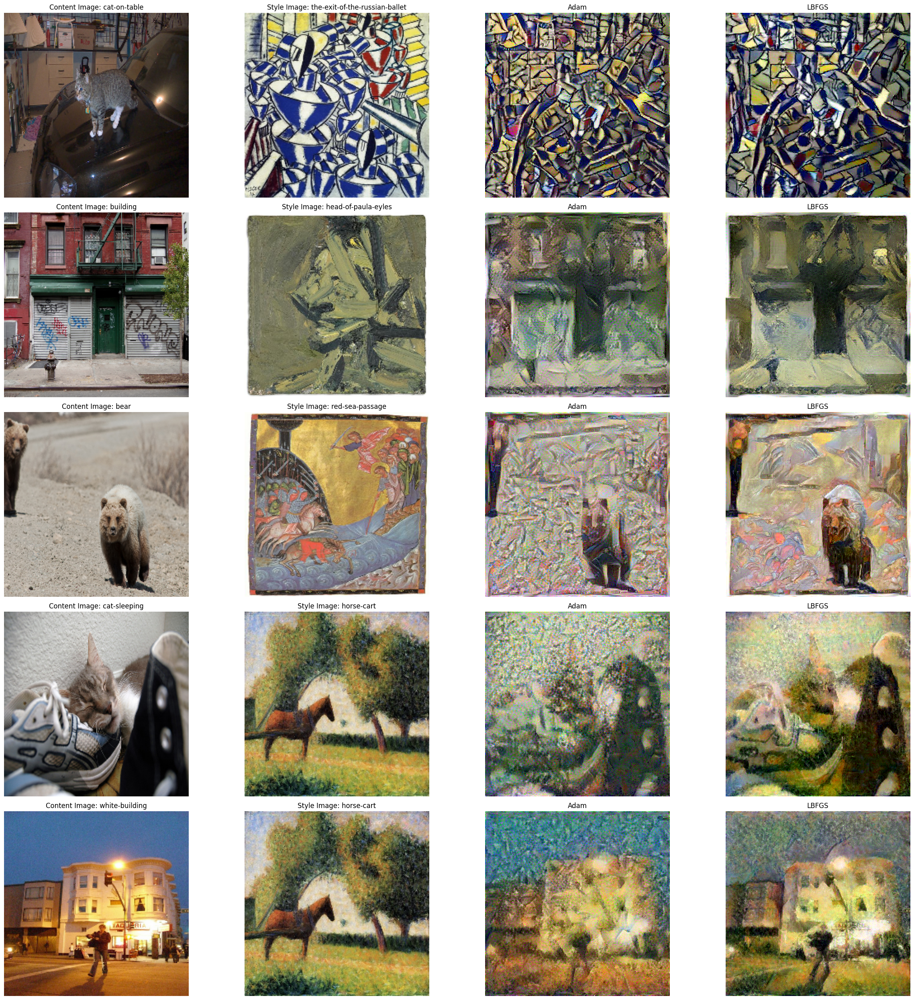

In [28]:
compare_adam_lbfgs(vgg_model, style_weight=1e9, content_weight=1e4)


The output by Adam is noisier than LBFGS output, which is also more visually appealing as a result. However, this is at the cost of time since LBFGS is muuch slower than adam.

## <a id='toc3_3_'></a>[visualizing difference between sgd, adam and lbfgs](#toc0_)

Snippet adapted from https://gist.github.com/tuelwer/0b52817e9b6251d940fd8e2921ec5e20  
Showing optimization on the non-convex Rosenbrock function, where the optimizer has to converge to the global minimum in the narrow valley.  
![Rosenbrock contour](Rosenbrock-contour.png)
Image By Nschloe - Own work, CC BY-SA 4.0, https://commons.wikimedia.org/w/index.php?curid=114931732

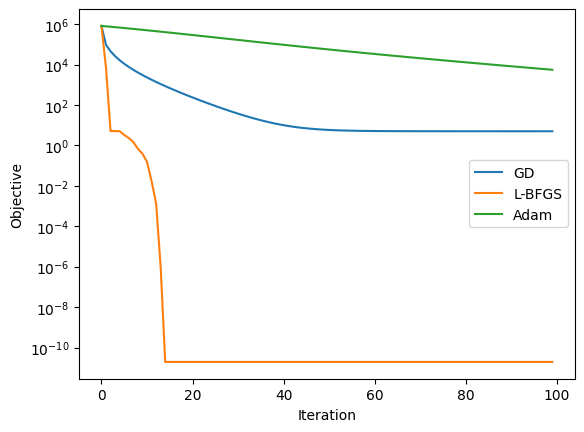

In [27]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt


# 2d Rosenbrock function
def f(x):
    return (1 - x[0])**2 + 100 * (x[1] - x[0]**2)**2


# Gradient descent
x_gd = 10*torch.ones(2, 1)
x_gd.requires_grad = True
gd = optim.SGD([x_gd], lr=1e-5)
history_gd = []
for i in range(100):
    gd.zero_grad()
    objective = f(x_gd)
    objective.backward()
    gd.step()
    history_gd.append(objective.item())

# Adam
x_adam = 10*torch.ones(2, 1)
x_adam.requires_grad = True
adam = optim.Adam([x_adam], lr=1e-1)
history_adam = []
for i in range(100):
    adam.zero_grad()
    objective = f(x_adam)
    objective.backward()
    adam.step()
    history_adam.append(objective.item())

# L-BFGS
def closure():
    lbfgs.zero_grad()
    objective = f(x_lbfgs)
    objective.backward()
    return objective

x_lbfgs = 10*torch.ones(2, 1)
x_lbfgs.requires_grad = True

lbfgs = optim.LBFGS([x_lbfgs],
                    history_size=10, 
                    max_iter=4, 
                    line_search_fn="strong_wolfe")
                    
history_lbfgs = []
for i in range(100):
    history_lbfgs.append(f(x_lbfgs).item())
    lbfgs.step(closure)


# Plotting
plt.semilogy(history_gd, label='GD')
plt.semilogy(history_lbfgs, label='L-BFGS')
plt.semilogy(history_adam, label='Adam')
plt.xlabel('Iteration')
plt.ylabel('Objective')
plt.legend()
plt.show()
